<div align="center">
    <h1 style="font-weight: 900">Training,Validation and Testing yolov5</h1>
        <p># Added SAHI Inference (This features used for checking the inference but it has worst performance such as missclassification.) </p>
    </div>
    

<div align="left">
    <h2>Name: Md Mahbubur Rahman (Saikat)</h2>
    <h2>Student Id.: 3820231103</h2>
    </div>

# **Setup For Training on Google Cloud**
N.B.: This experiment first run in google colab. I have used GPU server when it was available in my lab.

## Mount Google Drive

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Checking GPU

In [ ]:
!nvidia-smi

Mon May 20 16:08:22 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [1]:
import torch
print(torch.cuda.is_available())

True


In [ ]:
%cd /content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents

/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents


## Unzipping dataset program

In [ ]:
!pip install rarfile

In [ ]:
import os
from rarfile import RarFile

# Path to your RAR file
rar_file_path = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov5/2024testdataExt.rar'

# Path to the folder where you want to extract the files
extracted_folder_path = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov5/'

# Create the extracted folder if it doesn't exist
os.makedirs(extracted_folder_path, exist_ok=True)

# Open the RAR file
with RarFile(rar_file_path, 'r') as rar:
    # Extract all files to the specified folder
    rar.extractall(extracted_folder_path)

print("Extraction complete.")

Extraction complete.


# **Decompose Training Data**
I have divided data into two parts such as training and validation. We have used 85% data for training and 15% data for validation. 

In [ ]:
import os
import shutil
import random

def create_dir_structure(base_path):
    subdirs = ['images/train', 'images/val', 'labels/train', 'labels/val']
    for subdir in subdirs:
        os.makedirs(os.path.join(base_path, subdir), exist_ok=True)

def split_data(images_path, split_ratio=0.85):
    image_files = [f for f in os.listdir(images_path) if f.endswith(('.jpg', '.jpeg', '.png'))]
    random.shuffle(image_files)

    total_files = len(image_files)
    train_end = int(split_ratio * total_files)

    train_files = image_files[:train_end]
    val_files = image_files[train_end:]

    return train_files, val_files

def move_files(base_path, files, set_type):
    for file in files:
        image_src = os.path.join(base_path, 'images', file)
        label_src = os.path.join(base_path, 'labels', file.rsplit('.', 1)[0] + '.txt')

        image_dst = os.path.join(base_path, f'images/{set_type}', file)
        label_dst = os.path.join(base_path, f'labels/{set_type}', file.rsplit('.', 1)[0] + '.txt')

        if os.path.exists(image_src):
            shutil.move(image_src, image_dst)
        if os.path.exists(label_src):
            shutil.move(label_src, label_dst)

def main():
    base_path = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov8/dataset'

    # Step 1: Create directory structure
    create_dir_structure(base_path)

    # Step 2: Split the data
    images_path = os.path.join(base_path, 'images')
    train_files, val_files = split_data(images_path)

    # Step 3: Move the files
    move_files(base_path, train_files, 'train')
    move_files(base_path, val_files, 'val')

if __name__ == "__main__":
    main()


## Counting the images in the folder

We will use total 405 images for training our model.

In [ ]:
import os

folder_path = "/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov8/dataset/images/train/"

images = os.listdir(folder_path)

image_count = 0

for image in images:
  if image.lower().endswith(('.jpg', '.jpeg', '.gif', '.bmp')):
    image_count += 1

print("Number of images:", image_count)

Number of images: 405


# **Cloaning yolov5 repo & Environment Setup**

In [2]:
!git clone https://github.com/ultralytics/yolov5  # clone

正克隆到 'yolov5'...
remote: Enumerating objects: 16656, done.
remote: Counting objects: 100% (7/7), done.
remote: Compressing objects: 100% (7/7), done.
remote: Total 16656 (delta 1), reused 5 (delta 0), pack-reused 16649
接收对象中: 100% (16656/16656), 15.12 MiB | 1.29 MiB/s, 完成.
处理 delta 中: 100% (11438/11438), 完成.


In [3]:
%cd yolov5

/data01/user1/FinalProject/yolov5


## Installing Yolov5 Dependency

In [6]:
!pip install -r requirements.txt  # install

  Using cached GitPython-3.1.43-py3-none-any.whl.metadata (13 kB)
  Using cached gitdb-4.0.11-py3-none-any.whl.metadata (1.2 kB)
  Using cached smmap-5.0.1-py3-none-any.whl.metadata (4.3 kB)
Using cached GitPython-3.1.43-py3-none-any.whl (207 kB)
Using cached gitdb-4.0.11-py3-none-any.whl (62 kB)
Using cached smmap-5.0.1-py3-none-any.whl (24 kB)


## Tensorboard Logger

In [37]:
#@title Select YOLOv5 🚀 logger {run: 'auto'}
logger = 'TensorBoard' #@param ['Comet', 'ClearML', 'TensorBoard']

if logger == 'Comet':
  %pip install -q comet_ml
  import comet_ml; comet_ml.init()
elif logger == 'ClearML':
  %pip install -q clearml
  import clearml; clearml.browser_login()
elif logger == 'TensorBoard':
  %load_ext tensorboard
  %tensorboard --logdir runs/train

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 32410), started 1:37:47 ago. (Use '!kill 32410' to kill it.)

# **Experiment 1: (Yolov5s default)**

## Training inference on custom data

In [11]:
# Train YOLOv5s on custom-dataset for 300 epochs
!python train.py --img 640 --batch 16 --epochs 300 --data custom-dataset.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=custom-dataset.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
github: skipping check (offline), for updates see https://github.com/ultralytics/yolov5
YOLOv5 🚀 v7.0-318-gc0380fd8 Python-3.9.19 torch-2.3.0 CUDA:0 (GeForce RTX 2080 Ti, 11019MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1,

## Validating by pretrained model

In [12]:
!python val.py --weights /data01/user1/FinalProject/yolov5/runs/train/exp/weights/best.pt --data custom-dataset.yaml --img 640 --save-conf

val: data=/data01/user1/FinalProject/yolov5/data/custom-dataset.yaml, weights=['/data01/user1/FinalProject/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=True, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-318-gc0380fd8 Python-3.9.19 torch-2.3.0 CUDA:0 (GeForce RTX 2080 Ti, 11019MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /data01/user1/FinalProject/dataset/labels/val.cache... 72 images, 
                 Class     Images  Instances          P          R      mAP50   
                   all         72       3595      0.806      0.724      0.767      0.422
                person         72       3126      0.762      0.509      0.587      0.226
                   car         72        469

## Detecting images by trained weight

In [21]:
!python detect.py --weights /data01/user1/FinalProject/yolov5/runs/train/yolov5s_default/weights/best.pt --img 640 --conf 0.20 --source /data01/user1/FinalProject/yolov5/data/images --save-txt

detect: weights=['/data01/user1/FinalProject/yolov5/runs/train/yolov5s_default/weights/best.pt'], source=/data01/user1/FinalProject/yolov5/data/images, data=data/custom-dataset.yaml, imgsz=[640, 640], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-318-gc0380fd8 Python-3.9.19 torch-2.3.0 CUDA:0 (GeForce RTX 2080 Ti, 11019MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/477 /data01/user1/FinalProject/yolov5/data/images/171144514996762063.jpg: 384x640 29 cars, 38.9ms
image 2/477 /data01/user1/FinalProject/yolov5/data/images/171144516927913102.jpg: 384x640 28 cars, 4.2ms
image 3/477 /data01/user1/FinalProjec

## Calculating the avg Recall, Precision, Accuracy by calculate.py

In [38]:
!python /data01/user1/FinalProject/Yolov5Eval/calculate-yolov5-Exp1.py

Average Recall:  0.8341314761043557
Average Miss Rate:  0.1658685238956444
Average False Positive Rate:  0.0041928721174004195
Average Precision:  0.989068583408206
Average Accuracy:  0.8336822398060626
测试图片数量：477


## Visualizing all images by vis.py

In [ ]:
!python /data01/user1/FinalProject/Yolov5Eval/vis.py

# **Experiment 2: (Yolov5s Custom)**

In [29]:
import os
os.getcwd()

'/data01/user1/FinalProject/yolov5'

## Automate Hyperparameter Tuning
We have run 30 epochs with 100 iterations. Unfortunately, it was time consuming that is why pause running after 10 iterations.

In [31]:
!python train.py --img 640 --batch 16 --epochs 30 --data custom-dataset.yaml --weights yolov5s.pt --evolve 100

train: weights=yolov5s.pt, cfg=, data=custom-dataset.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=30, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=100, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
github: skipping check (offline), for updates see https://github.com/ultralytics/yolov5
YOLOv5 🚀 v7.0-318-gc0380fd8 Python-3.9.19 torch-2.3.0 CUDA:0 (GeForce RTX 2080 Ti, 11019MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, 

## Training ...

In [34]:
# Train YOLOv5s on custom-dataset for 300 epochs
!python -m torch.distributed.run --nproc_per_node 4 train.py --img 640 --batch 32 --epochs 300 --data custom-dataset.yaml --weights yolov5s.pt --hyp data/hyps/hyp_evolve5s.yaml --optimizer AdamW --device 0,1,2,3
#!python train.py --img 640 --batch 32 --epochs 300 --data custom-dataset.yaml --weights yolov5s.pt --hyp data/hyps/hyp_evolve5s.yaml --optimizer Adam

*****************************************
Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed. 
*****************************************
train: weights=yolov5s.pt, cfg=, data=custom-dataset.yaml, hyp=data/hyps/hyp_evolve5s.yaml, epochs=300, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=None, image_weights=False, device=0,1,2,3, multi_scale=False, single_cls=False, optimizer=AdamW, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest, ndjson_console=False, ndjson_file=False
github: skippi

## Detecting images by trained weight

In [40]:
!python detect.py --weights /data01/user1/FinalProject/yolov5/runs/train/yolov5s_custom/weights/best.pt --img 640 --conf 0.20 --source /data01/user1/FinalProject/yolov5/data/images --save-txt

detect: weights=['/data01/user1/FinalProject/yolov5/runs/train/yolov5s_custom/weights/best.pt'], source=/data01/user1/FinalProject/yolov5/data/images, data=data/custom-dataset.yaml, imgsz=[640, 640], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-318-gc0380fd8 Python-3.9.19 torch-2.3.0 CUDA:0 (GeForce RTX 2080 Ti, 11019MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/477 /data01/user1/FinalProject/yolov5/data/images/171144514996762063.jpg: 384x640 32 cars, 39.3ms
image 2/477 /data01/user1/FinalProject/yolov5/data/images/171144516927913102.jpg: 384x640 32 cars, 4.2ms
image 3/477 /data01/user1/FinalProject

In [42]:
!python /data01/user1/FinalProject/Yolov5Eval/calculate-yolov5-Exp2.py

Average Recall:  0.8486826864500888
Average Miss Rate:  0.15131731354991051
Average False Positive Rate:  0.012578616352201259
Average Precision:  0.9923787680601097
Average Accuracy:  0.8475659524193085
测试图片数量：477


# **Performance Evaluation for Experiment 1**:

## Performance Evaluation on Test data

In [7]:
!python detect.py --weights /data01/user1/FinalProject/yolov5/runs/train/yolov5s_default/weights/best.pt --img 640 --conf 0.20 --source /data01/user1/FinalProject/2024testdataExt/images/ --save-txt

detect: weights=['/data01/user1/FinalProject/yolov5/runs/train/yolov5s_default/weights/best.pt'], source=/data01/user1/FinalProject/2024testdataExt/images/, data=data/custom-dataset.yaml, imgsz=[640, 640], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-318-gc0380fd8 Python-3.9.19 torch-2.3.0 CUDA:0 (GeForce RTX 2080 Ti, 11019MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/43 /data01/user1/FinalProject/2024testdataExt/images/171144514919825515.jpg: 384x640 28 cars, 39.7ms
image 2/43 /data01/user1/FinalProject/2024testdataExt/images/171144538633269676.jpg: 384x640 21 cars, 4.1ms
image 3/43 /data01/user1/F

## Testing on pretrained model by Testdataset

In [8]:
!python /data01/user1/FinalProject/Yolov5Eval/evalutetestdata-on-Exp1.py

Average Recall:  0.5318536120458579
Average Miss Rate:  0.46814638795414204
Average False Positive Rate:  0.046511627906976744
Average Precision:  0.8333333333333333
Average Accuracy:  0.531603214049042
测试图片数量：43


In [ ]:
!python /content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov5/testdataset/testvis.py

# **Performance Evaluation for Experiment 2:**

## Performance Evaluation on Test data

In [43]:
!python detect.py --weights /data01/user1/FinalProject/yolov5/runs/train/yolov5s_default/weights/best.pt --img 640 --conf 0.20 --source /data01/user1/FinalProject/2024testdataExt/images/ --save-txt

detect: weights=['/data01/user1/FinalProject/yolov5/runs/train/yolov5s_default/weights/best.pt'], source=/data01/user1/FinalProject/2024testdataExt/images/, data=data/custom-dataset.yaml, imgsz=[640, 640], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-318-gc0380fd8 Python-3.9.19 torch-2.3.0 CUDA:0 (GeForce RTX 2080 Ti, 11019MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/43 /data01/user1/FinalProject/2024testdataExt/images/171144514919825515.jpg: 384x640 28 cars, 39.0ms
image 2/43 /data01/user1/FinalProject/2024testdataExt/images/171144538633269676.jpg: 384x640 21 cars, 4.0ms
image 3/43 /data01/user1/F

## Testing on pretrained model by Testdataset

In [46]:
!python /data01/user1/FinalProject/Yolov5Eval/evalutetestdata-on-Exp2.py

Average Recall:  0.5783652399528347
Average Miss Rate:  0.4216347600471653
Average False Positive Rate:  0.046511627906976744
Average Precision:  0.87984496124031
Average Accuracy:  0.5781148419560187
测试图片数量：43


## Moving images to another folder.

Since i was worked on google colab, i had to move the object sometimes.

In [ ]:
import os
import shutil

# Specify the source and destination paths
source_path = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov5/runs/detect/exp4'  # Replace with your source folder path
destination_path = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov5/runs/detect/exp4/images'  # Replace with your destination folder path

# Check if the destination directory exists, create it if it does not
if not os.path.exists(destination_path):
    os.makedirs(destination_path)

# Loop through all files in the source directory
for filename in os.listdir(source_path):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):  # Check for image files
        source_file = os.path.join(source_path, filename)
        destination_file = os.path.join(destination_path, filename)

        # Move each file to the destination directory
        shutil.move(source_file, destination_file)
        print(f'Moved {filename} to {destination_path}')

print('All images have been moved.')

# **Future Work**

# **Use SAHI for Inference**

In [ ]:
%cd YOLOv5+SAHI

/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/YOLOv5+SAHI


In [ ]:
!pip install -U torch sahi yolov5

In [ ]:
import os
os.getcwd()

'/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/YOLOv5+SAHI'

In [ ]:
# import required functions, classes
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image

In [ ]:
# this is our pretrained model'
yolov5_model_path = 'models/best.pt'

## 1. Standard Inference with our pretrained yolov5 Model

- Instantiate a detection model by defining model weight path and other parameters:

In [ ]:
detection_model = AutoDetectionModel.from_pretrained(
    model_type='yolov5',
    model_path=yolov5_model_path,
    confidence_threshold=0.3,
    device="cpu", # or 'cuda:0'
)

- Perform prediction by feeding the get_prediction function with an image path and a DetectionModel instance:

In [ ]:
result = get_prediction("demo_data/171159381930896910.jpg", detection_model)

- Or perform prediction by feeding the get_prediction function with a numpy image and a DetectionModel instance:

In [ ]:
result = get_prediction(read_image("demo_data/171159381930896910.jpg"), detection_model)

- Visualize predicted bounding boxes and masks over the original image:

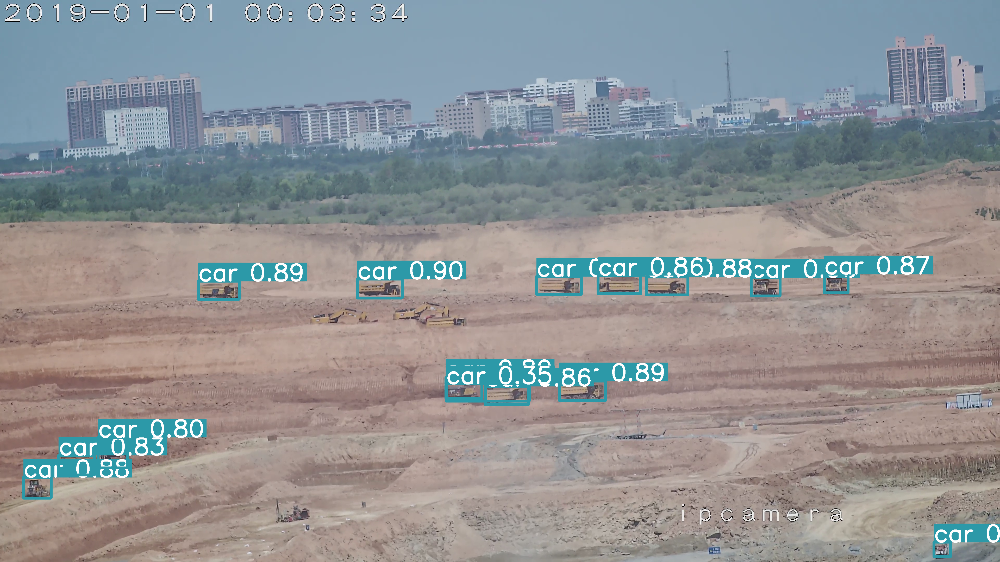

In [ ]:
result.export_visuals(export_dir="demo_data/", file_name="pred_171159381930896910")

Image("demo_data/pred_171159381930896910.png")

## 2. Sliced Inference with our pretrained yolov5 Model

- To perform sliced prediction we need to specify slice parameters. In this example we will perform prediction over slices of 512x512 with an overlap ratio of 0.2:

In [ ]:
result = get_sliced_prediction(
    "demo_data/171159381930896910.jpg",
    detection_model,
    slice_height = 512,
    slice_width = 512,
    overlap_height_ratio = 0.2,
    overlap_width_ratio = 0.2
)

Performing prediction on 60 slices.


- Visualize predicted bounding boxes and masks over the original image:

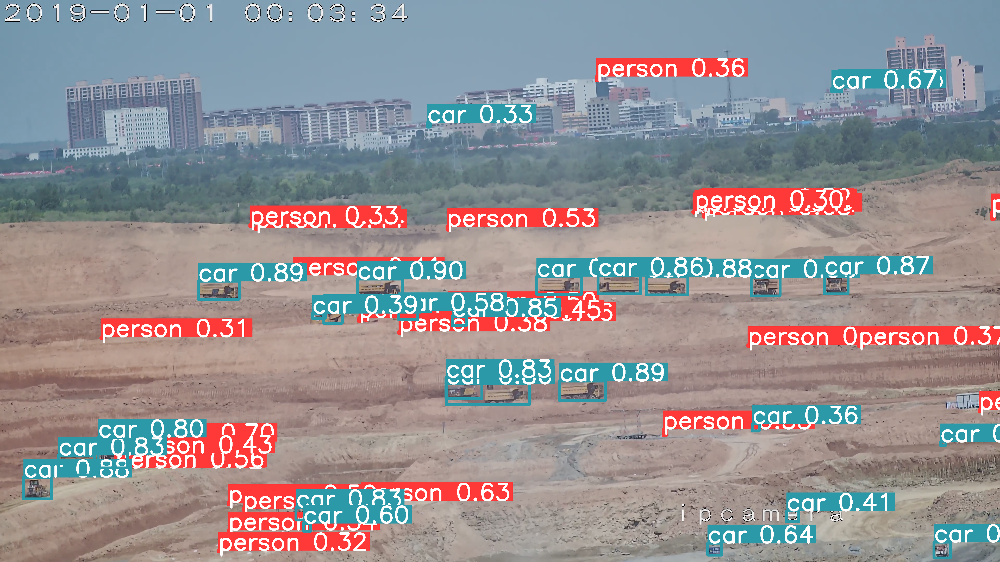

In [ ]:
result.export_visuals(export_dir="demo_data/", file_name="pred_171159381930896910")

Image("demo_data/pred_171159381930896910.png")

## 3. Prediction Result

In [ ]:
object_prediction_list = result.object_prediction_list

In [ ]:
object_prediction_list[0]

ObjectPrediction<
    bbox: BoundingBox: <(483.9164352416992, 1696.7631912231445, 494.8504943847656, 1730.2037506103516), w: 10.934059143066406, h: 33.44055938720703>,
    mask: None,
    score: PredictionScore: <value: 0.7023668885231018>,
    category: Category: <id: 0, name: person>>

In [ ]:
object_prediction_list

[ObjectPrediction<
     bbox: BoundingBox: <(483.9164352416992, 1696.7631912231445, 494.8504943847656, 1730.2037506103516), w: 10.934059143066406, h: 33.44055938720703>,
     mask: None,
     score: PredictionScore: <value: 0.7023668885231018>,
     category: Category: <id: 0, name: person>>,
 ObjectPrediction<
     bbox: BoundingBox: <(1695.659278869629, 1197.53076171875, 1705.0509185791016, 1217.6859130859375), w: 9.391639709472656, h: 20.1551513671875>,
     mask: None,
     score: PredictionScore: <value: 0.6839621067047119>,
     category: Category: <id: 0, name: person>>,
 ObjectPrediction<
     bbox: BoundingBox: <(3806.1647033691406, 814.3236694335938, 3818.0126342773438, 842.2674312591553), w: 11.847930908203125, h: 27.943761825561523>,
     mask: None,
     score: PredictionScore: <value: 0.6832938194274902>,
     category: Category: <id: 0, name: person>>,
 ObjectPrediction<
     bbox: BoundingBox: <(2699.6644744873047, 825.2915925979614, 2707.3599853515625, 834.808044433593

In [ ]:
result.to_coco_annotations() #[:3]

[{'image_id': None,
  'bbox': [483.9164352416992,
   1696.7631912231445,
   10.934059143066406,
   33.44055938720703],
  'score': 0.7023668885231018,
  'category_id': 0,
  'category_name': 'person',
  'segmentation': [],
  'iscrowd': 0,
  'area': 365},
 {'image_id': None,
  'bbox': [1695.659278869629,
   1197.53076171875,
   9.391639709472656,
   20.1551513671875],
  'score': 0.6839621067047119,
  'category_id': 0,
  'category_name': 'person',
  'segmentation': [],
  'iscrowd': 0,
  'area': 189},
 {'image_id': None,
  'bbox': [3806.1647033691406,
   814.3236694335938,
   11.847930908203125,
   27.943761825561523],
  'score': 0.6832938194274902,
  'category_id': 0,
  'category_name': 'person',
  'segmentation': [],
  'iscrowd': 0,
  'area': 331},
 {'image_id': None,
  'bbox': [2699.6644744873047,
   825.2915925979614,
   7.6955108642578125,
   9.516451835632324],
  'score': 0.648337721824646,
  'category_id': 0,
  'category_name': 'person',
  'segmentation': [],
  'iscrowd': 0,
  'area'

- ObjectPrediction's can be converted to [imantics](https://github.com/jsbroks/imantics) annotation format:

In [ ]:
result.to_coco_predictions(image_id=1)[:3]

[{'image_id': 1,
  'bbox': [483.9164352416992,
   1696.7631912231445,
   10.934059143066406,
   33.44055938720703],
  'score': 0.7023668885231018,
  'category_id': 0,
  'category_name': 'person',
  'segmentation': [],
  'iscrowd': 0,
  'area': 365},
 {'image_id': 1,
  'bbox': [1695.659278869629,
   1197.53076171875,
   9.391639709472656,
   20.1551513671875],
  'score': 0.6839621067047119,
  'category_id': 0,
  'category_name': 'person',
  'segmentation': [],
  'iscrowd': 0,
  'area': 189},
 {'image_id': 1,
  'bbox': [3806.1647033691406,
   814.3236694335938,
   11.847930908203125,
   27.943761825561523],
  'score': 0.6832938194274902,
  'category_id': 0,
  'category_name': 'person',
  'segmentation': [],
  'iscrowd': 0,
  'area': 331}]

In [ ]:
!pip install -U imantics
!pip install -U fiftyone

In [ ]:
result.to_imantics_annotations()[:3]

- ObjectPrediction's can be converted to [fiftyone](https://github.com/voxel51/fiftyone) detection format:

In [ ]:
result.to_fiftyone_detections()[:3]

[<Detection: {
     'id': '664eb8c035caf58b8abf25d1',
     'attributes': {},
     'tags': [],
     'label': 'person',
     'bounding_box': [
         0.12601990501085916,
         0.7855385144551595,
         0.002847411235173543,
         0.015481740457040292,
     ],
     'mask': None,
     'confidence': 0.7023668885231018,
     'index': None,
 }>,
 <Detection: {
     'id': '664eb8c035caf58b8abf25d2',
     'attributes': {},
     'tags': [],
     'label': 'person',
     'bounding_box': [
         0.44157793720563254,
         0.5544123896846065,
         0.0024457395076751707,
         0.00933108859592014,
     ],
     'mask': None,
     'confidence': 0.6839621067047119,
     'index': None,
 }>,
 <Detection: {
     'id': '664eb8c035caf58b8abf25d3',
     'attributes': {},
     'tags': [],
     'label': 'person',
     'bounding_box': [
         0.9911887248357137,
         0.377001698811849,
         0.0030853986740112306,
         0.012936926771093298,
     ],
     'mask': None,
     '

## 4. Batch Prediction

- Set model and directory parameters:

### Sliced Inference by yolov5s.pt pretrained weight

In [ ]:
yolov5_model_path = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov5/runs/train/exp2/weights/yolov5s.pt'

model_type = "yolov5"
model_path = yolov5_model_path
model_device = "0" # or 'cpu'
model_confidence_threshold = 0.3

slice_height = 512
slice_width = 512
overlap_height_ratio = 0.2
overlap_width_ratio = 0.2

source_image_dir = "/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/YOLOv5+SAHI/demo_data/Pred-yolov5s-default/"

predict(
    model_type=model_type,
    model_path=model_path,
    model_device=model_device,
    model_confidence_threshold=model_confidence_threshold,
    source=source_image_dir,
    slice_height=slice_height,
    slice_width=slice_width,
    overlap_height_ratio=overlap_height_ratio,
    overlap_width_ratio=overlap_width_ratio,
)

There are 10 listed files in folder: Pred-yolov5s-default/


Performing inference on images:   0%|          | 0/10 [00:00<?, ?it/s]

Performing prediction on 15 slices.


Performing inference on images:  10%|█         | 1/10 [00:09<01:29,  9.96s/it]

Prediction time is: 9440.07 ms


Performing inference on images:  10%|█         | 1/10 [00:10<01:29,  9.96s/it]

Performing prediction on 15 slices.


Performing inference on images:  10%|█         | 1/10 [00:18<01:29,  9.96s/it]

Prediction time is: 8050.22 ms


Performing inference on images:  20%|██        | 2/10 [00:19<01:14,  9.31s/it]

Performing prediction on 15 slices.


Performing inference on images:  30%|███       | 3/10 [00:28<01:06,  9.45s/it]

Prediction time is: 8898.93 ms


Performing inference on images:  30%|███       | 3/10 [00:28<01:06,  9.45s/it]

Performing prediction on 15 slices.


Performing inference on images:  30%|███       | 3/10 [00:36<01:06,  9.45s/it]

Prediction time is: 7528.83 ms


Performing inference on images:  40%|████      | 4/10 [00:36<00:53,  8.88s/it]

Performing prediction on 15 slices.


Performing inference on images:  40%|████      | 4/10 [00:46<00:53,  8.88s/it]

Prediction time is: 9246.68 ms


Performing inference on images:  50%|█████     | 5/10 [00:46<00:46,  9.26s/it]

Performing prediction on 60 slices.


Performing inference on images:  50%|█████     | 5/10 [01:19<00:46,  9.26s/it]

Prediction time is: 32618.88 ms


Performing inference on images:  60%|██████    | 6/10 [01:20<01:10, 17.72s/it]

Performing prediction on 60 slices.


Performing inference on images:  60%|██████    | 6/10 [01:52<01:10, 17.72s/it]

Prediction time is: 31376.95 ms


Performing inference on images:  70%|███████   | 7/10 [01:53<01:07, 22.61s/it]

Performing prediction on 60 slices.


Performing inference on images:  70%|███████   | 7/10 [02:25<01:07, 22.61s/it]

Prediction time is: 32042.93 ms


Performing inference on images:  80%|████████  | 8/10 [02:26<00:51, 25.94s/it]

Performing prediction on 60 slices.


Performing inference on images:  80%|████████  | 8/10 [03:04<00:51, 25.94s/it]

Prediction time is: 37787.40 ms


Performing inference on images:  90%|█████████ | 9/10 [03:05<00:29, 29.96s/it]

Performing prediction on 60 slices.


Performing inference on images:  90%|█████████ | 9/10 [03:38<00:29, 29.96s/it]

Prediction time is: 33493.75 ms


Performing inference on images: 100%|██████████| 10/10 [03:39<00:00, 21.97s/it]

Prediction results are successfully exported to runs/predict/exp


In [ ]:
!pip install matplotlib Pillow

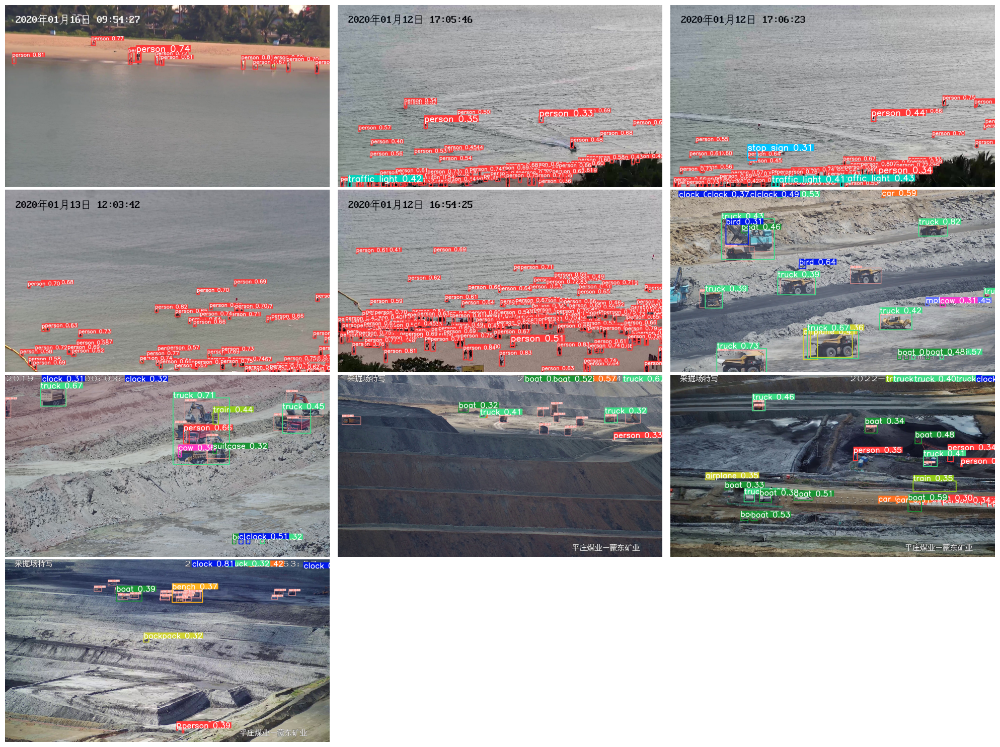

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Define the path to your image directory
image_dir = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/YOLOv5+SAHI/runs/predict/exp/visuals'

# List all files in the image directory
image_files = os.listdir(image_dir)

# Select the first 10 image files (you can choose any number you like)
selected_images = image_files[:10]

# Set up the plot
plt.figure(figsize=(20, 15))

# Loop through the selected images and display them
for i, image_file in enumerate(selected_images, 1):
    # Load the image
    image_path = os.path.join(image_dir, image_file)
    image = Image.open(image_path)

    # Display the image
    plt.subplot(4, 3, i)
    plt.imshow(image)
    plt.axis('off')

# Show the plot
plt.tight_layout(h_pad=0.2)
plt.show()


### Sliced Inference by our pretrained weight (best.pt)

In [ ]:
model_type = "yolov5"
model_path = "/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/yolov5/runs/train/exp2/weights/best.pt"#yolov5_model_path
model_device = "cpu" # or 'cuda:0'
model_confidence_threshold = 0.3

slice_height = 512
slice_width = 512
overlap_height_ratio = 0.2
overlap_width_ratio = 0.2

source_image_dir = "/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/YOLOv5+SAHI/demo_data/Pred-yolov5s-default/"

predict(
    model_type=model_type,
    model_path=model_path,
    model_device=model_device,
    model_confidence_threshold=model_confidence_threshold,
    source=source_image_dir,
    slice_height=slice_height,
    slice_width=slice_width,
    overlap_height_ratio=overlap_height_ratio,
    overlap_width_ratio=overlap_width_ratio,
)



There are 10 listed files in folder: Pred-yolov5s-default/


Performing inference on images:   0%|          | 0/10 [00:00<?, ?it/s]

Performing prediction on 15 slices.


Performing inference on images:   0%|          | 0/10 [00:14<?, ?it/s]

Prediction time is: 14161.72 ms


Performing inference on images:  10%|█         | 1/10 [00:14<02:09, 14.42s/it]

Performing prediction on 15 slices.


Performing inference on images:  10%|█         | 1/10 [00:24<02:09, 14.42s/it]

Prediction time is: 10395.73 ms


Performing inference on images:  20%|██        | 2/10 [00:25<01:39, 12.39s/it]

Performing prediction on 15 slices.


Performing inference on images:  20%|██        | 2/10 [00:38<01:39, 12.39s/it]

Prediction time is: 13140.70 ms


Performing inference on images:  30%|███       | 3/10 [00:38<01:30, 12.88s/it]

Performing prediction on 15 slices.


Performing inference on images:  30%|███       | 3/10 [00:49<01:30, 12.88s/it]

Prediction time is: 10510.15 ms


Performing inference on images:  40%|████      | 4/10 [00:49<01:12, 12.05s/it]

Performing prediction on 15 slices.


Performing inference on images:  40%|████      | 4/10 [01:00<01:12, 12.05s/it]

Prediction time is: 10443.61 ms


Performing inference on images:  50%|█████     | 5/10 [01:00<00:57, 11.59s/it]

Performing prediction on 60 slices.


Performing inference on images:  50%|█████     | 5/10 [01:42<00:57, 11.59s/it]

Prediction time is: 41444.70 ms


Performing inference on images:  60%|██████    | 6/10 [01:43<01:28, 22.09s/it]

Performing prediction on 60 slices.


Performing inference on images:  60%|██████    | 6/10 [02:25<01:28, 22.09s/it]

Prediction time is: 42074.45 ms


Performing inference on images:  70%|███████   | 7/10 [02:26<01:27, 29.01s/it]

Performing prediction on 60 slices.


Performing inference on images:  70%|███████   | 7/10 [03:08<01:27, 29.01s/it]

Prediction time is: 42575.35 ms


Performing inference on images:  80%|████████  | 8/10 [03:10<01:07, 33.72s/it]

Performing prediction on 60 slices.


Performing inference on images:  80%|████████  | 8/10 [03:51<01:07, 33.72s/it]

Prediction time is: 40952.83 ms


Performing inference on images:  90%|█████████ | 9/10 [03:52<00:36, 36.29s/it]

Performing prediction on 60 slices.


Performing inference on images:  90%|█████████ | 9/10 [04:32<00:36, 36.29s/it]

Prediction time is: 40644.80 ms


Performing inference on images: 100%|██████████| 10/10 [04:33<00:00, 27.40s/it]

Prediction results are successfully exported to runs/predict/exp2


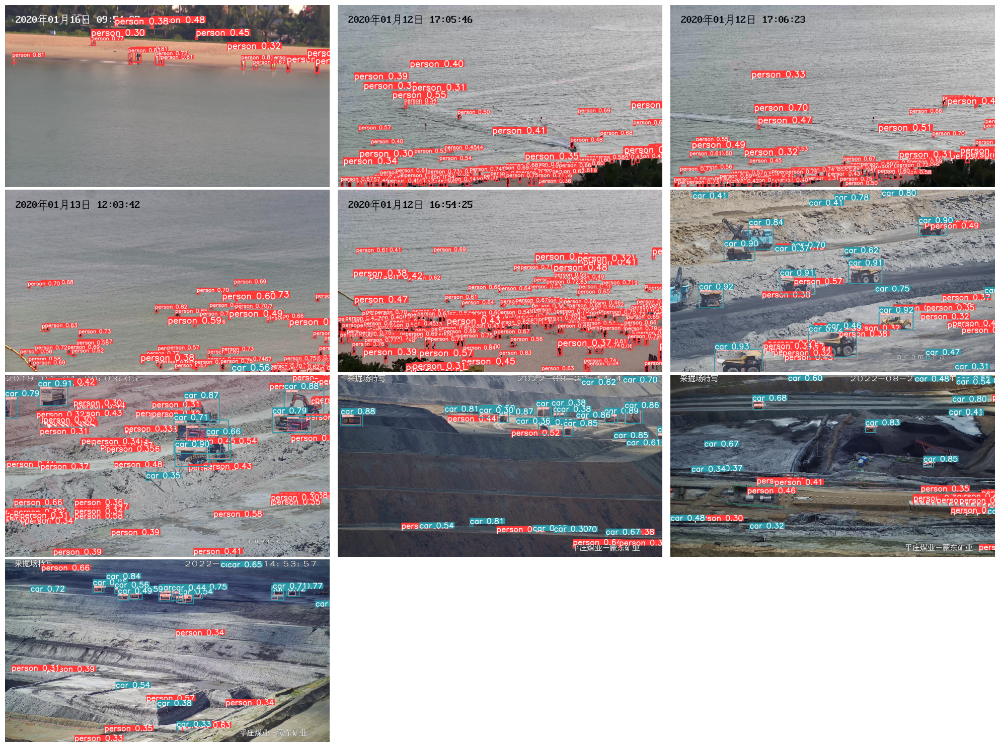

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Define the path to your image directory
image_dir = '/content/drive/MyDrive/DeepLearningAndImageAnalysis/2024DLFinalProjForStudents/YOLOv5+SAHI/runs/predict/exp2/visuals'

# List all files in the image directory
image_files = os.listdir(image_dir)

# Select the first 10 image files (you can choose any number you like)
selected_images = image_files[:10]

# Set up the plot
plt.figure(figsize=(20, 15))

# Loop through the selected images and display them
for i, image_file in enumerate(selected_images, 1):
    # Load the image
    image_path = os.path.join(image_dir, image_file)
    image = Image.open(image_path)

    # Display the image
    plt.subplot(4, 3, i)
    plt.imshow(image)
    plt.axis('off')

# Show the plot
plt.tight_layout(h_pad=0.2)
plt.show()
